# Import Library

In [1]:
import os
import re
import cv2
import ast
import random
import pandas as pd
import numpy as np

from PIL import Image
import albumentations as A
from collections import namedtuple
from albumentations.pytorch.transforms import ToTensorV2

import matplotlib.pyplot as plt
import matplotlib.patches as patches

from pathlib import Path


# Load sino dataset


In [2]:
import os
import cv2


def get_custom_data_dicts(images_dir, labels_dir):
    dataset_dicts = []

    # Get list of label files
    label_files = os.listdir(labels_dir)

    for label_file in label_files:
        # Extract image id from label file name
        image_id = label_file.split('.')[0]
        image_path = os.path.join(images_dir, f"{image_id}.jpg")
        label_path = os.path.join(labels_dir, label_file)

        # Load image to get width and height
        img = cv2.imread(image_path)
        height, width, _ = img.shape

        # Read label file
        with open(label_path, 'r') as f:
            lines = f.readlines()

        objs = []
        for line in lines:
            data = line.strip().split()
            class_0, x_center, y_center, w, h = map(float, data)
            
            x_min = int((x_center - w / 2) * width)
            y_min = int((y_center - h / 2) * height)
            x_max = int((x_center + w / 2) * width)
            y_max = int((y_center + h / 2) * height)

            record = {
                "image_id": image_id,
                "height": height,
                "width": width,
                "x_min": x_min,
                "y_min": y_min,
                "x_max": x_max,
                "y_max": y_max,
            }

            dataset_dicts.append(record)
    
    df = pd.DataFrame(dataset_dicts)

    return df


In [3]:
train_dir = "/your-path/images/train"

In [4]:
# Path to image and label directories train
images_dir_train = "/your-path/images/train"
labels_dir_train = "/your-path/labels/train"

df = get_custom_data_dicts(images_dir_train, labels_dir_train)

df.to_excel('excel_data_dict.xlsx')

print("Using this excel file to check the same size images for CutMix Augmentation")
df

Using this excel file to check the same size images for CutMix Augmentation


,image_id,height,width,x_min,y_min,x_max,y_max
0,nlvnpf-0137-01-019,607,900,571,162,603,189
1,nlvnpf-0137-01-019,607,900,390,390,421,419
2,nlvnpf-0137-01-019,607,900,572,189,602,212
3,nlvnpf-0137-01-019,607,900,432,100,471,122
4,nlvnpf-0137-01-019,607,900,430,78,473,99
...,...,...,...,...,...,...,...
13664,nlvnpf-0137-01-014,607,900,202,184,232,210
13665,nlvnpf-0137-01-014,607,900,527,185,559,210
13666,nlvnpf-0137-01-014,607,900,342,157,374,187
13667,nlvnpf-0137-01-014,607,900,201,209,234,238


# Helper functions

In [5]:
def draw_rect(img, bboxes, color=(255, 0, 0)):
    img = img.copy()
    for bbox in bboxes:
        bbox = np.array(bbox).astype(int)
        pt1, pt2 = (bbox[0], bbox[1]), (bbox[2], bbox[3])
        img = cv2.rectangle(img, pt1, pt2, color, int(max(img.shape[:2]) / 200))
    return img

def read_img(img_id):
    img_path = train_dir + '/' + img_id +'.jpg'
    img = cv2.imread(str(img_path))
    return img

def read_bboxes(img_id):
    return df.loc[df.image_id == img_id, 'x_min y_min x_max y_max'.split()].values

def plot_img(img_id, bbox=False):
    img    = read_img(img_id)
    if bbox:
        bboxes = read_bboxes(img_id)
        img    = draw_rect(img, bboxes)
    plt.imshow(img);
    
def plot_multiple_img(img_matrix_list, title_list, ncols, nrows=3, main_title=""):
    fig, myaxes = plt.subplots(figsize=(20, 15), nrows=nrows, ncols=ncols, squeeze=False)
    fig.suptitle(main_title, fontsize = 30)
    fig.subplots_adjust(wspace=0.3)
    fig.subplots_adjust(hspace=0.3)
    for i, (img, title) in enumerate(zip(img_matrix_list, title_list)):
        
        myaxes[i // ncols][i % ncols].imshow(img)
        myaxes[i // ncols][i % ncols].set_title(title, fontsize=15)
        myaxes[i // ncols][i % ncols].grid(False)
        myaxes[i // ncols][i % ncols].set_xticks([])
        myaxes[i // ncols][i % ncols].set_yticks([])

    plt.show()

### Bounding Boxes Annotation Format

Augmenting images is easy and straight forward. But things get pretty complex when you start working with bounding boxes. When you transform an image, the coordinates of bounding boxes are also altered. Apply same transformations to your image and bounding box is very sophisticated and prone to errors. Things get even more complex when you start chaining these transformations. 

Lucky for us, albumentations library supports working with bounding boxes. You should refer [this](https://albumentations.ai/docs/getting_started/bounding_boxes_augmentation/) doc page for more details. 

The most important thing when working with bounding boxes is the **annotations**. There are different annotations formats for bounding boxes. Each format uses its specific representation of bouning boxes coordinates. Albumentations supports four formats: `pascal_voc`, `albumentations`, `coco`, and `yolo`. The image below will help you understand different annotations better.

![](https://albumentations.ai/docs/images/getting_started/augmenting_bboxes/bbox_formats.jpg)

**Note:** Different models (like yolo, faster-rcnn, etc.) expects bboxes in different formats. So, before using any model just make sure that you know the annotation type that it uses. And then format your bboxes accordingly.

# Fundamental types of augmentation¶


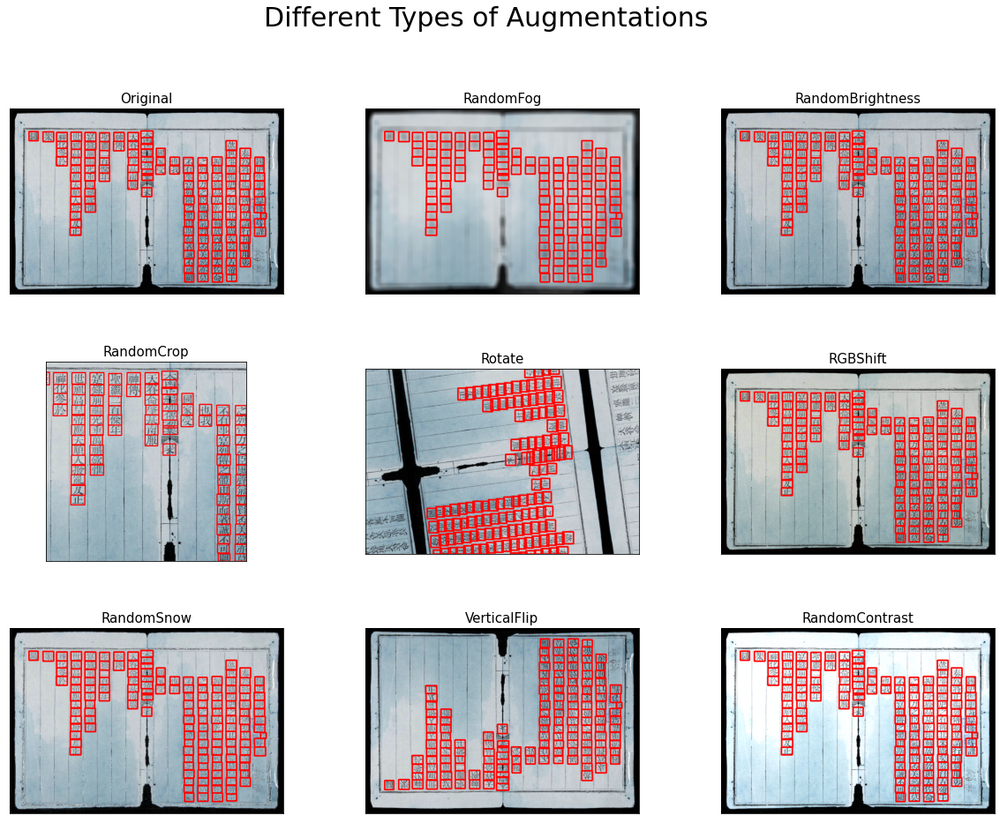

In [6]:
img_id = 'nlvnpf-0137-01-001'
chosen_img = read_img(img_id)
bboxes = read_bboxes(img_id)
bbox_params = {'format': 'pascal_voc', 'label_fields': ['labels']}

albumentation_list = [A.Compose([A.RandomFog(p=1)], bbox_params=bbox_params),
                      A.Compose([A.RandomBrightness(p=1)], bbox_params=bbox_params),
                      A.Compose([A.RandomCrop(p=1, height=512, width=512)], bbox_params=bbox_params), 
                      A.Compose([A.Rotate(p=1, limit=90)], bbox_params=bbox_params),
                      A.Compose([A.RGBShift(p=1)], bbox_params=bbox_params), 
                      A.Compose([A.RandomSnow(p=1)], bbox_params=bbox_params),
                      A.Compose([A.VerticalFlip(p=1)], bbox_params=bbox_params), 
                      A.Compose([A.RandomContrast(limit=0.5, p = 1)], bbox_params=bbox_params)
                     ]

titles_list = ["Original", 
               "RandomFog",
               "RandomBrightness", 
               "RandomCrop",
               "Rotate", 
               "RGBShift", 
               "RandomSnow", 
               "VerticalFlip", 
               "RandomContrast"]

img_matrix_list = [draw_rect(chosen_img, bboxes)]

for aug_type in albumentation_list:
    anno = aug_type(image=chosen_img, bboxes=bboxes, labels=np.ones(len(bboxes)))
    img  = draw_rect(anno['image'], anno['bboxes'])
    img_matrix_list.append(img)

plot_multiple_img(img_matrix_list, 
                  titles_list, 
                  ncols = 3, 
                  main_title="Different Types of Augmentations")

In [7]:
img_list_chu_trang_nen_den = [
    "nlvnpf-0174-03-001",
    "nlvnpf-0174-03-003",
    "nlvnpf-0174-03-004",
    "nlvnpf-0174-03-005",
    "nlvnpf-0174-03-006",
    "nlvnpf-0174-03-007",
    "nlvnpf-0174-03-012",
]

In [8]:
img_list_chu_be = [
    "nlvnpf-0137-01-005",
    "nlvnpf-0137-01-007",
    "nlvnpf-0137-01-008",
    "nlvnpf-0137-01-010",
    "nlvnpf-0137-01-011",
    "nlvnpf-0137-01-012",
    "nlvnpf-0137-01-014",
    "nlvnpf-0137-01-015",
    "nlvnpf-0137-01-016",
    "nlvnpf-0137-01-017",
    "nlvnpf-0137-01-024",
    "nlvnpf-0137-01-033",
    "nlvnpf-0137-01-040",
    "nlvnpf-0137-01-043",
    "nlvnpf-0137-01-044",
    "nlvnpf-0140-01-015",
    "nlvnpf-0174-03-002",
    "nlvnpf-0174-03-012",
]

In [9]:
img_list_chu_nhat = [
    "nlvnpf-0140-01-007",
    "nlvnpf-0140-01-008",
    "nlvnpf-0140-01-009",
    "nlvnpf-0140-01-010",
    "nlvnpf-0140-01-011",
    "nlvnpf-0140-01-012",
    "nlvnpf-0140-01-013",
]

In [10]:
img_list_vet_ban = [
    "nlvnpf-0137-01-002",
    "nlvnpf-0137-01-003",
    "nlvnpf-0137-01-004",
    "nlvnpf-0137-01-006",
    "nlvnpf-0137-01-009",
    "nlvnpf-0137-01-012",
    "nlvnpf-0137-01-037",
    "nlvnpf-0140-01-015",
    "nlvnpf-0174-03-009",
]

In [11]:
img_list = img_list_chu_be
aug_set = "chu_size_be/"

# Albumentation augmentation

In [12]:
# Define paths
output_img_dir = aug_set + 'output_albu/images'
output_label_dir = aug_set + 'output_albu/label'
output_check_dir = aug_set + 'output_albu/check'

# Ensure output directories exist
os.makedirs(output_img_dir, exist_ok=True)
os.makedirs(output_label_dir, exist_ok=True)
os.makedirs(output_check_dir, exist_ok=True)

In [13]:
bbox_params = {'format': 'pascal_voc', 'label_fields': ['labels']}

albumentation_list = [A.Compose([A.Rotate(p=1, limit=15)], bbox_params=bbox_params),
                      A.Compose([A.InvertImg(p=1)], bbox_params=bbox_params), 
                      A.Compose([A.Blur(blur_limit=10, p=1)], bbox_params=bbox_params),
                      A.Compose([A.RandomSizedBBoxSafeCrop(height=1000, width=1000)], bbox_params=bbox_params),
                      A.Compose([A.Resize(300,300)], bbox_params=bbox_params)]

titles_list = ["Rotate",
               "InvertImg", 
               "Blur", 
               "RamdomSizedBBoxSafeCrop",
               "Resize"]


for img_id in img_list:
    chosen_img = read_img(img_id)
    bboxes = read_bboxes(img_id)

    img_bbox_matrix_list = []
    anno_img_matrix_list = []
    anno_bbox_matrix_list = []

    for i, aug_type in enumerate(albumentation_list):
        anno = aug_type(image=chosen_img, bboxes=bboxes, labels=np.ones(len(bboxes)))
        img  = draw_rect(anno['image'], anno['bboxes'])
        anno_img_matrix_list.append(anno['image'])
        anno_bbox_matrix_list.append(anno['bboxes'])

        cv2.imwrite(os.path.join(output_check_dir, f'{img_id}_augcheck_{titles_list[i]}.jpg'), img)
        cv2.imwrite(os.path.join(output_img_dir, f'{img_id}_aug_{titles_list[i]}.jpg'), anno['image'])

        with open(os.path.join(output_label_dir, f'{img_id}_aug_{titles_list[i]}.txt'), 'w') as label_file:
            img_height, img_width, _ = img.shape
            for bbox in anno['bboxes']:
                x_min, y_min, x_max, y_max = bbox
                # Calculate bbox in YOLO format
                x_center = (x_min + x_max) / 2 / img_width
                y_center = (y_min + y_max) / 2 / img_height
                width = (x_max - x_min) / img_width
                height = (y_max - y_min) / img_height
                # Write to label file
                label_file.write(f'0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n')
    

# Advance Augmentations

In recent times, many new augmentation techniques have been devloped. Some of them are extremely powerful. When applied, they can help your model generalize better and make it more robust. We will look are 2 of them that we think it will improve the robustness of HandWriten Sinonom Detection: 
- CutOut
- CutMix

Lets get started . . .

# Cutout Augmentation

**CutOut** is a technique for regularizing CNN models. It works by masking square regions of the image. By randomly masking regions of the image we can prevent the model from falling prey to noice in the data and overfit. 

**Note:** Reading research papers is one of the most under rated skill set in Deep Learning community, but to become a good practitioner you must regularly spend time reading research papers. This [cutout paper](https://arxiv.org/pdf/1708.04552) is an easy read, give it a try.

Albumentations already has a working implementation of CutOut. So, we will use it directly. 

In [14]:
from albumentations.augmentations.transforms import Cutout

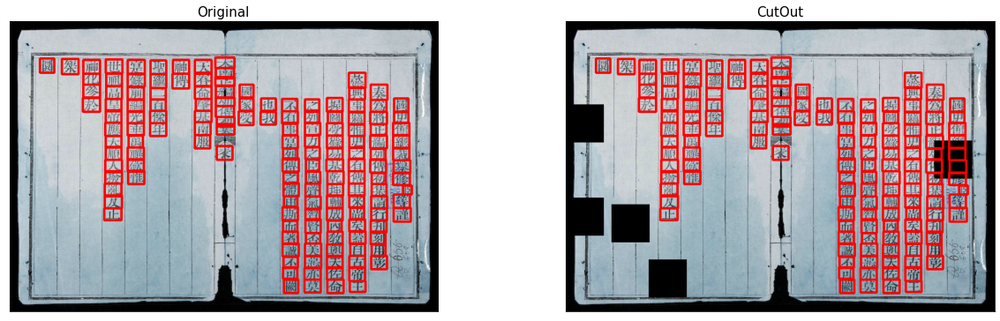

In [15]:
img_id = 'nlvnpf-0137-01-001' 
chosen_img = read_img(img_id)
bboxes = read_bboxes(img_id)

bbox_params = {'format': 'pascal_voc', 'label_fields': ['labels']}
augmentation = A.Compose([Cutout(num_holes=5, 
                                 max_h_size=80, 
                                 max_w_size=80, 
                                 fill_value=0, 
                                 p=1),
                         ], 
                         bbox_params=bbox_params)

img_matrix_list = [draw_rect(chosen_img, bboxes)]

anno = augmentation(image=chosen_img, bboxes=bboxes, labels=np.ones(len(bboxes)))
img  = draw_rect(anno['image'], anno['bboxes'])
img_matrix_list.append(img)

titles_list = ["Original", "CutOut"]

plot_multiple_img(img_matrix_list, titles_list, ncols = 2, nrows= 1, main_title="")

There is one problem with this, if you make the `max_h_size` and `max_w_size` very high, say 250 px. Then you will have some bounding boxes inside the patch. This is what I am talking about. 
This makes it really difficult for the model to learn from the images. Ideally, we should also remove the bounding boxes that lies inside the mask. So, I would recommend you to use it with small values of `max_h_size` and `max_w_size`. 

**Note:** All the data augmentation techniques that we have use so far can be applied to any type of computer vision problem. From here on, the code can only be used for object detection.

In [16]:
from albumentations.core.transforms_interface import DualTransform
from albumentations.augmentations.bbox_utils import denormalize_bbox, normalize_bbox

class CustomCutout(DualTransform):
    """
    Custom Cutout augmentation with handling of bounding boxes 
    Note: (only supports square cutout regions)
    
    Author: Kaushal28
    Reference: https://arxiv.org/pdf/1708.04552.pdf
    """
    
    def __init__(
        self,
        fill_value=0,
        bbox_removal_threshold=0.50,
        min_cutout_size=192,
        max_cutout_size=512,
        always_apply=False,
        p=0.5
    ):
        """
        Class construstor
        
        :param fill_value: Value to be filled in cutout (default is 0 or black color)
        :param bbox_removal_threshold: Bboxes having content cut by cutout path more than this threshold will be removed
        :param min_cutout_size: minimum size of cutout (192 x 192)
        :param max_cutout_size: maximum size of cutout (512 x 512)
        """
        super(CustomCutout, self).__init__(always_apply, p)  # Initialize parent class
        self.fill_value = fill_value
        self.bbox_removal_threshold = bbox_removal_threshold
        self.min_cutout_size = min_cutout_size
        self.max_cutout_size = max_cutout_size
        
    def _get_cutout_position(self, img_height, img_width, cutout_size):
        """
        Randomly generates cutout position as a named tuple
        
        :param img_height: height of the original image
        :param img_width: width of the original image
        :param cutout_size: size of the cutout patch (square)
        :returns position of cutout patch as a named tuple
        """
        position = namedtuple('Point', 'x y')
        return position(
            np.random.randint(0, img_width - cutout_size + 1),
            np.random.randint(0, img_height - cutout_size + 1)
        )
        
    def _get_cutout(self, img_height, img_width):
        """
        Creates a cutout pacth with given fill value and determines the position in the original image
        
        :param img_height: height of the original image
        :param img_width: width of the original image
        :returns (cutout patch, cutout size, cutout position)
        """
        cutout_size = np.random.randint(self.min_cutout_size, self.max_cutout_size + 1)
        cutout_position = self._get_cutout_position(img_height, img_width, cutout_size)
        return np.full((cutout_size, cutout_size, 3), self.fill_value), cutout_size, cutout_position
        
    def apply(self, image, **params):
        """
        Applies the cutout augmentation on the given image
        
        :param image: The image to be augmented
        :returns augmented image
        """
        image = image.copy()  # Don't change the original image
        self.img_height, self.img_width, _ = image.shape
        cutout_arr, cutout_size, cutout_pos = self._get_cutout(self.img_height, self.img_width)
        
        # Set to instance variables to use this later
        self.image = image
        self.cutout_pos = cutout_pos
        self.cutout_size = cutout_size
        
        image[cutout_pos.y:cutout_pos.y+cutout_size, cutout_pos.x:cutout_size+cutout_pos.x, :] = cutout_arr
        return image
    
    def apply_to_bbox(self, bbox, **params):
        """
        Removes the bounding boxes which are covered by the applied cutout
        
        :param bbox: A single bounding box coordinates in pascal_voc format
        :returns transformed bbox's coordinates
        """

        # Denormalize the bbox coordinates
        bbox = denormalize_bbox(bbox, self.img_height, self.img_width)
        x_min, y_min, x_max, y_max = tuple(map(int, bbox))

        bbox_size = (x_max - x_min) * (y_max - y_min)  # width * height
        overlapping_size = np.sum(
            (self.image[y_min:y_max, x_min:x_max, 0] == self.fill_value) &
            (self.image[y_min:y_max, x_min:x_max, 1] == self.fill_value) &
            (self.image[y_min:y_max, x_min:x_max, 2] == self.fill_value)
        )

        # Remove the bbox if it has more than some threshold of content is inside the cutout patch
        if overlapping_size / bbox_size > self.bbox_removal_threshold:
            return normalize_bbox((0, 0, 0, 0), self.img_height, self.img_width)

        return normalize_bbox(bbox, self.img_height, self.img_width)

    def get_transform_init_args_names(self):
        """
        Fetches the parameter(s) of __init__ method
        :returns: tuple of parameter(s) of __init__ method
        """
        return ('fill_value', 'bbox_removal_threshold', 'min_cutout_size', 'max_cutout_size', 'always_apply', 'p')

In [17]:
import cv2
import os

output_dir_cutout_label = aug_set + 'output_cutout/label'
output_dir_cutout_images = aug_set + 'output_cutout/images'
output_dir_cutout_double_check = aug_set + 'output_cutout/check'
os.makedirs(output_dir_cutout_label, exist_ok=True)
os.makedirs(output_dir_cutout_images, exist_ok=True)
os.makedirs(output_dir_cutout_double_check, exist_ok=True)

In [18]:

for img_id in img_list:
    chosen_img = read_img(img_id)
    bboxes = read_bboxes(img_id)

    bbox_params = {'format': 'pascal_voc', 'label_fields': ['labels']}
    augmentation = A.Compose([CustomCutout(p=1),], bbox_params = bbox_params)

    img_matrix_list = [draw_rect(chosen_img, bboxes)]

    anno = augmentation(image=chosen_img, bboxes=bboxes, labels=np.ones(len(bboxes)))
    img  = draw_rect(anno['image'], anno['bboxes'])
    img_matrix_list.append(img)
    
    combined_img = np.vstack(img_matrix_list) 
    
    # SAVE AUGMENTED IMAGE AND LABEL 
    cv2.imwrite(os.path.join(output_dir_cutout_images, f'{img_id}_aug_cutout.jpg'), anno['image'])
    cv2.imwrite(os.path.join(output_dir_cutout_double_check, f'{img_id}_aug_cutout_check.jpg'), combined_img)

    # convert Pascal VOC to YOLO format and save output
    with open(os.path.join(output_dir_cutout_label, f'{img_id}_aug_cutout.txt'), 'w') as label_file:
        img_height, img_width, _ = img.shape
        for bbox in anno['bboxes']:
             # convert Pascal VOC to YOLO format
            x_min, y_min, x_max, y_max = bbox
            x_center = (x_min + x_max) / 2 / img_width
            y_center = (y_min + y_max) / 2 / img_height
            width = (x_max - x_min) / img_width
            height = (y_max - y_min) / img_height

            # save output
            label_file.write(f'0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n')
    print("Save images and label of", img_id, "successfully")

Save images and label of nlvnpf-0137-01-005 successfully
Save images and label of nlvnpf-0137-01-007 successfully
Save images and label of nlvnpf-0137-01-008 successfully
Save images and label of nlvnpf-0137-01-010 successfully
Save images and label of nlvnpf-0137-01-011 successfully
Save images and label of nlvnpf-0137-01-012 successfully
Save images and label of nlvnpf-0137-01-014 successfully
Save images and label of nlvnpf-0137-01-015 successfully
Save images and label of nlvnpf-0137-01-016 successfully
Save images and label of nlvnpf-0137-01-017 successfully
Save images and label of nlvnpf-0137-01-024 successfully
Save images and label of nlvnpf-0137-01-033 successfully
Save images and label of nlvnpf-0137-01-040 successfully
Save images and label of nlvnpf-0137-01-043 successfully
Save images and label of nlvnpf-0137-01-044 successfully
Save images and label of nlvnpf-0140-01-015 successfully
Save images and label of nlvnpf-0174-03-002 successfully
Save images and label of nlvnpf

# CutMix Augmentation


In [19]:
def rand_bbox(size, lamb):
    """ Generate random bounding box 
    Args:
        - size: [width, breadth] of the bounding box
        - lamb: (lambda) cut ratio parameter
    Returns:
        - Bounding box
    """
    W = size[0]
    H = size[1]
    cut_rat = np.sqrt(1. - lamb)
    cut_w = np.int(W * cut_rat)
    cut_h = np.int(H * cut_rat)

    # uniform
    cx = np.random.randint(W)
    cy = np.random.randint(H)

    bbx1 = np.clip(cx - cut_w // 2, 0, W)
    bby1 = np.clip(cy - cut_h // 2, 0, H)
    bbx2 = np.clip(cx + cut_w // 2, 0, W)
    bby2 = np.clip(cy + cut_h // 2, 0, H)

    return bbx1, bby1, bbx2, bby2


def generate_cutmix_image(images, bboxes, beta=1.0, th=0.25):
    """ Generate a CutMix augmented image from a batch 
    Args:
        - image_batch: a batch of input images
        - image_batch_labels: labels corresponding to the image batch
        - beta: a parameter of Beta distribution.
    Returns:
        - CutMix image batch, updated labels
    """
    # generate mixed sample
    fill_value = 255
    lam = np.random.beta(beta, beta)
    target_a = bboxes[0]
    target_b = bboxes[1]
    w, h, c = images[0].shape
    bbx1, bby1, bbx2, bby2 = rand_bbox((w,h,c), lam)
    cutmix_image = images[0].copy()
    cutmix_image[bby1:bby2, bbx1:bbx2, :] = fill_value
    
    # bboxes
    new_bboxes = []
    for bbox in bboxes[0]:
        x_min, y_min, x_max, y_max = map(int, bbox)
    
        bbox_size = (x_max - x_min) * (y_max - y_min)  # width * height
        overlapping_size = np.sum(
            (cutmix_image[y_min:y_max, x_min:x_max, 0] == fill_value) &
            (cutmix_image[y_min:y_max, x_min:x_max, 1] == fill_value) &
            (cutmix_image[y_min:y_max, x_min:x_max, 2] == fill_value)
        )

        # Add the bbox if it has less than some threshold of content is inside the cutout patch
        if overlapping_size / bbox_size < th:
            new_bboxes.append(bbox)
            
    mask = np.zeros(images[1].shape)
    mask[bby1:bby2, bbx1:bbx2, :] = 1
    image2 = images[1]*mask
    
    for bbox in bboxes[1]:
        x_min, y_min, x_max, y_max = map(int, bbox)
    
        bbox_size = (x_max - x_min) * (y_max - y_min)  # width * height
        overlapping_size = np.sum(
            (image2[y_min:y_max, x_min:x_max, 0] == 0) &
            (image2[y_min:y_max, x_min:x_max, 1] == 0) &
            (image2[y_min:y_max, x_min:x_max, 2] == 0)
        )

        # Add the bbox if it has less than some threshold of content is inside the cutout patch
        if overlapping_size / bbox_size < th:
            new_bboxes.append(bbox)
    
    cutmix_image[bby1:bby2, bbx1:bbx2, :] = image2[bby1:bby2, bbx1:bbx2, :]
        
    return cutmix_image, new_bboxes

In [20]:
# Đường dẫn đến thư mục lưu hình ảnh và tập tin nhãn
output_dir_cutmix_label = aug_set + 'output_cutmix/label'
output_dir_cutmix_images = aug_set + 'output_cutmix/images'
output_dir_cutmix_double_check = aug_set + 'output_cutmix/check'
os.makedirs(output_dir_cutmix_label, exist_ok=True)
os.makedirs(output_dir_cutmix_images, exist_ok=True)
os.makedirs(output_dir_cutmix_double_check, exist_ok=True)

In [21]:


from itertools import combinations

def generate_image_combinations(img_list):
    '''
        # input: 
        img_list = ['nlvnpf-0137-01-001', 'nlvnpf-0137-01-003', 'nlvnpf-0137-01-004']

        # output: is combine 2 of images in img_list
        image_ids_list = [
            ['nlvnpf-0137-01-001', 'nlvnpf-0137-01-003'],
            ['nlvnpf-0137-01-001', 'nlvnpf-0137-01-004'],    
            ['nlvnpf-0137-01-003', 'nlvnpf-0137-01-004'],
        ]
    '''
    # Generate combinations of 2 images from img_list
    image_combinations = list(combinations(img_list, 2))
    
    # Convert combinations to a list of lists
    image_ids_list = [list(comb) for comb in image_combinations]
    
    return image_ids_list


image_ids_list = generate_image_combinations(img_list)

In [22]:
def get_image_height_width(image_id):
    # Load the image using cv2
    img = cv2.imread(image_id)  
    
    # Get the height and width of the image
    height, width, _ = img.shape
    
    return height, width

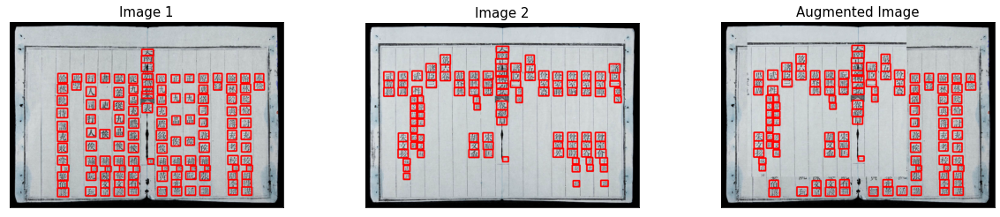

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-007 successfully
Incompatible shape in  ['nlvnpf-0137-01-005', 'nlvnpf-0137-01-008']


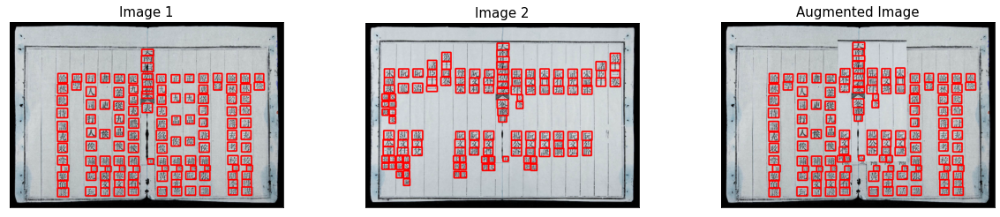

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-010 successfully


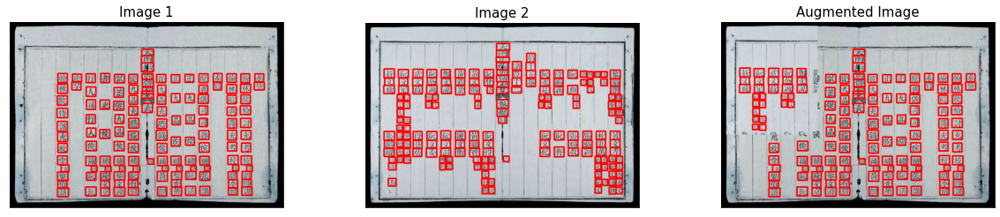

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-011 successfully
Incompatible shape in  ['nlvnpf-0137-01-005', 'nlvnpf-0137-01-012']


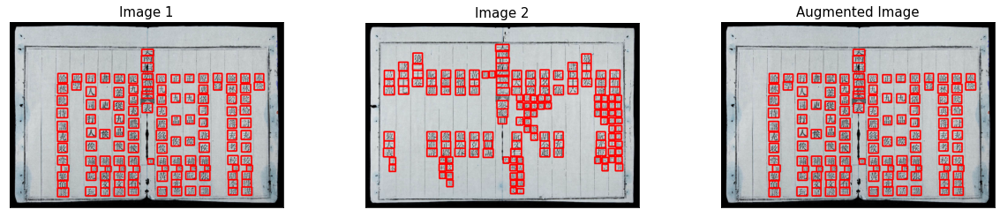

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-014 successfully


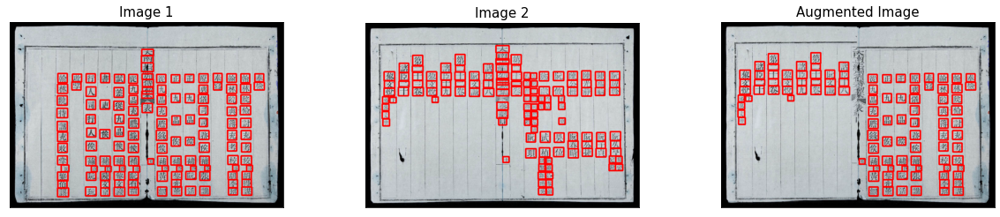

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-015 successfully


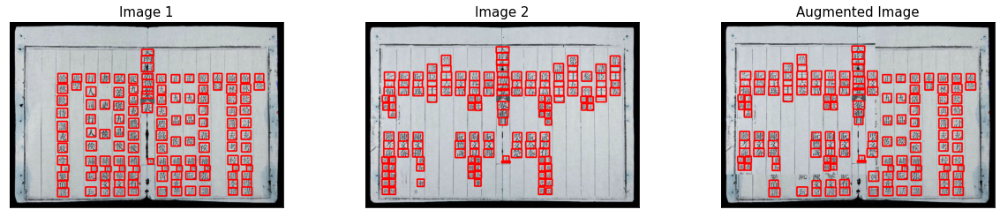

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-016 successfully


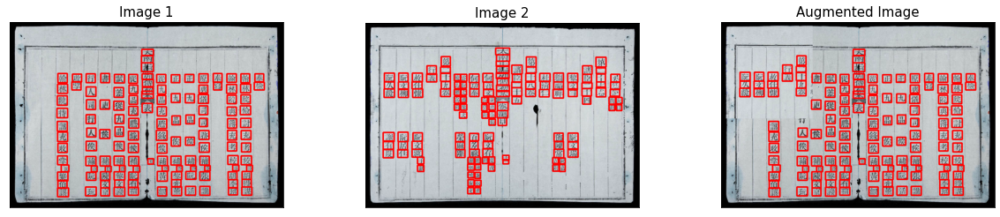

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-017 successfully
Incompatible shape in  ['nlvnpf-0137-01-005', 'nlvnpf-0137-01-024']


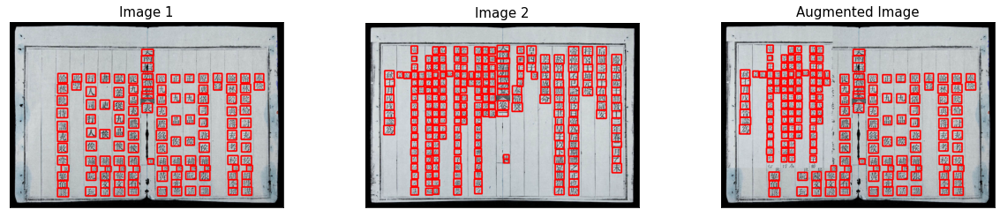

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-033 successfully
Incompatible shape in  ['nlvnpf-0137-01-005', 'nlvnpf-0137-01-040']


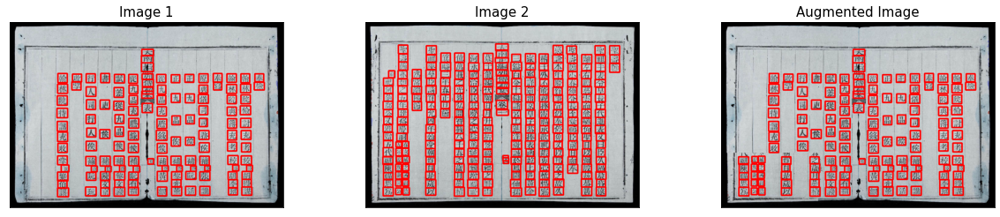

Save images and label of nlvnpf-0137-01-005_nlvnpf-0137-01-043 successfully
Incompatible shape in  ['nlvnpf-0137-01-005', 'nlvnpf-0137-01-044']
Incompatible shape in  ['nlvnpf-0137-01-005', 'nlvnpf-0140-01-015']


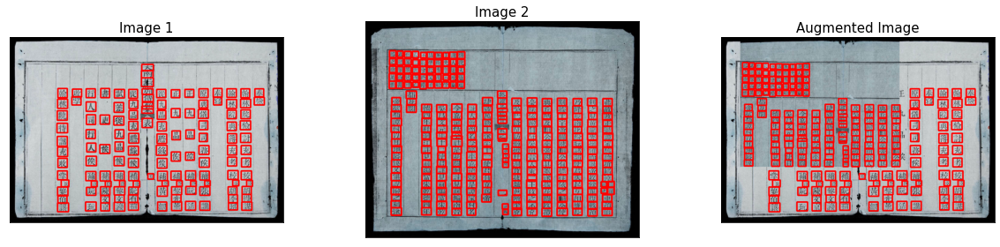

Incompatible shape in  ['nlvnpf-0137-01-005', 'nlvnpf-0174-03-002']


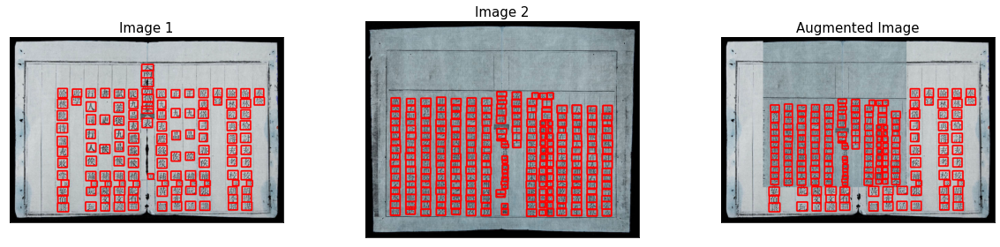

Incompatible shape in  ['nlvnpf-0137-01-005', 'nlvnpf-0174-03-012']


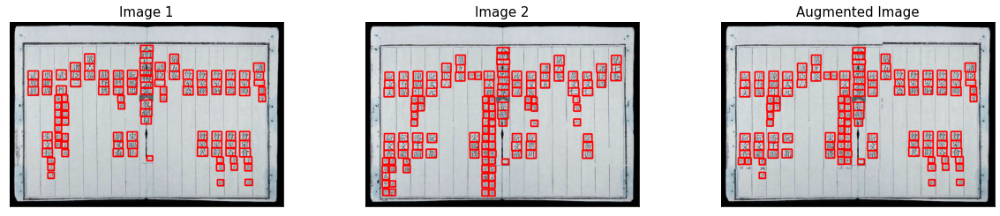

Save images and label of nlvnpf-0137-01-007_nlvnpf-0137-01-008 successfully


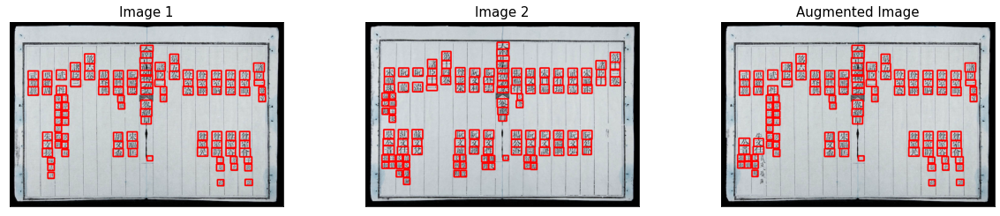

Save images and label of nlvnpf-0137-01-007_nlvnpf-0137-01-010 successfully


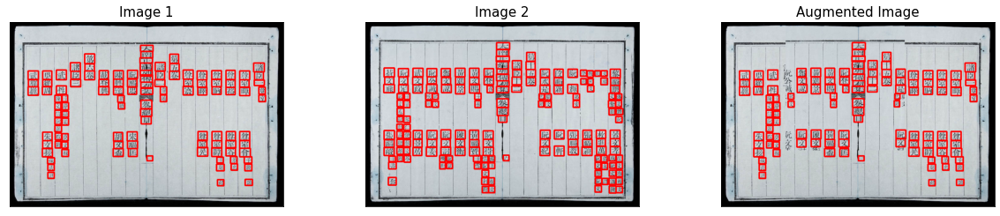

Save images and label of nlvnpf-0137-01-007_nlvnpf-0137-01-011 successfully
Incompatible shape in  ['nlvnpf-0137-01-007', 'nlvnpf-0137-01-012']
Incompatible shape in  ['nlvnpf-0137-01-007', 'nlvnpf-0137-01-014']


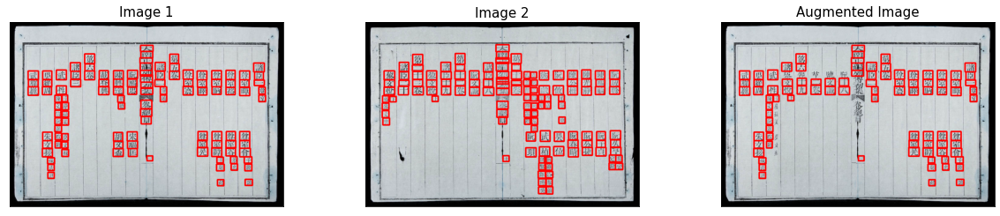

Save images and label of nlvnpf-0137-01-007_nlvnpf-0137-01-015 successfully
Incompatible shape in  ['nlvnpf-0137-01-007', 'nlvnpf-0137-01-016']


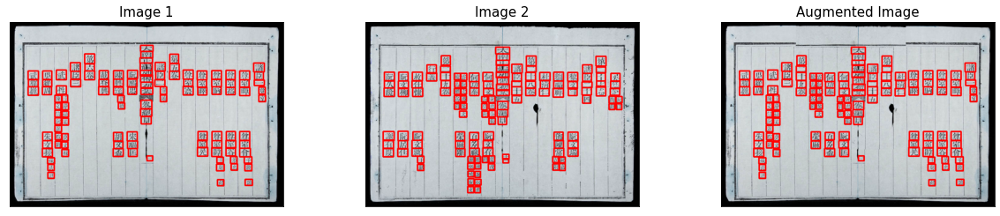

Save images and label of nlvnpf-0137-01-007_nlvnpf-0137-01-017 successfully
Incompatible shape in  ['nlvnpf-0137-01-007', 'nlvnpf-0137-01-024']


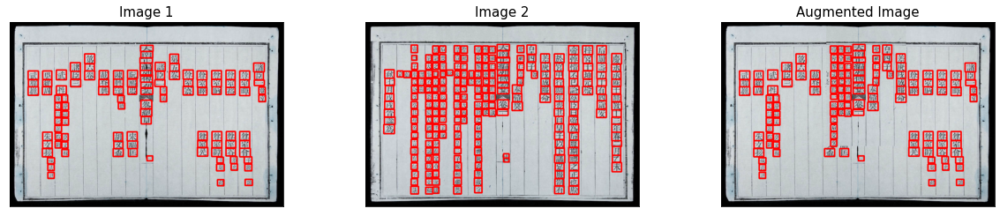

Save images and label of nlvnpf-0137-01-007_nlvnpf-0137-01-033 successfully
Incompatible shape in  ['nlvnpf-0137-01-007', 'nlvnpf-0137-01-040']


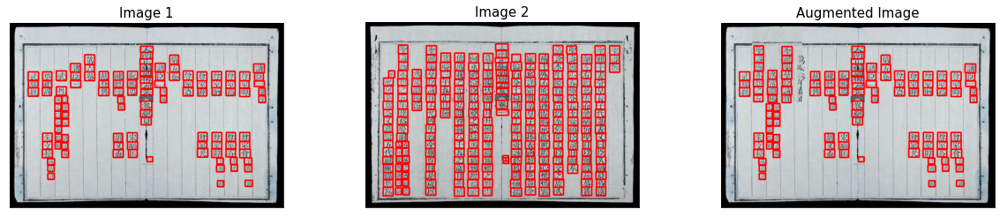

Save images and label of nlvnpf-0137-01-007_nlvnpf-0137-01-043 successfully


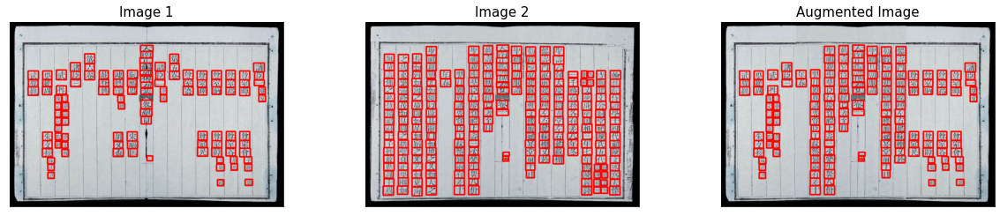

Save images and label of nlvnpf-0137-01-007_nlvnpf-0137-01-044 successfully
Incompatible shape in  ['nlvnpf-0137-01-007', 'nlvnpf-0140-01-015']
Incompatible shape in  ['nlvnpf-0137-01-007', 'nlvnpf-0174-03-002']


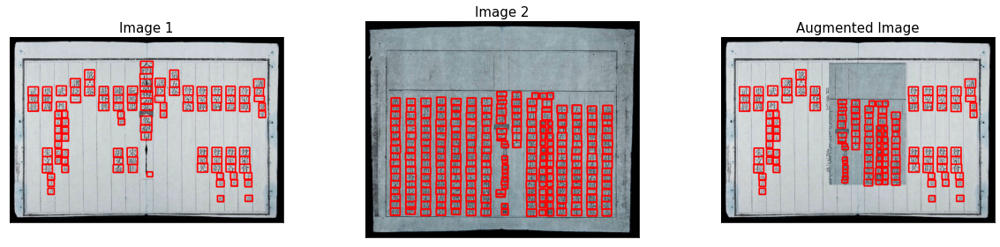

Incompatible shape in  ['nlvnpf-0137-01-007', 'nlvnpf-0174-03-012']


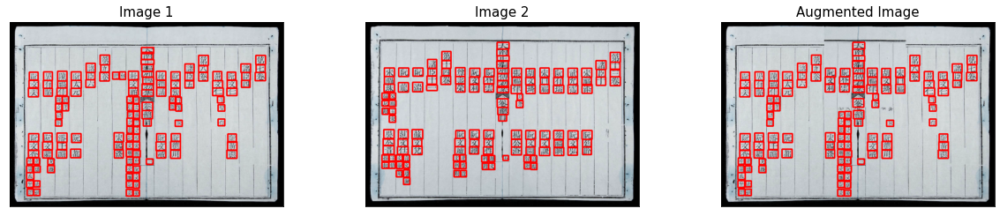

Save images and label of nlvnpf-0137-01-008_nlvnpf-0137-01-010 successfully
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0137-01-011']
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0137-01-012']


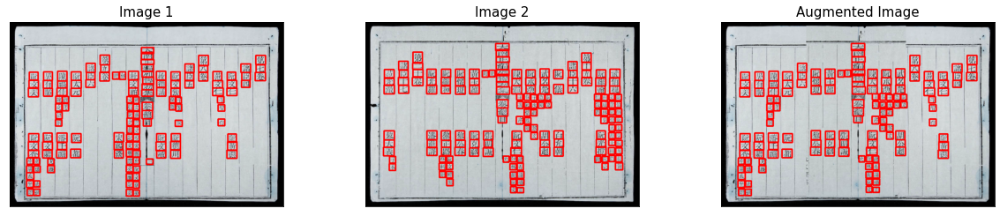

Save images and label of nlvnpf-0137-01-008_nlvnpf-0137-01-014 successfully
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0137-01-015']
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0137-01-016']


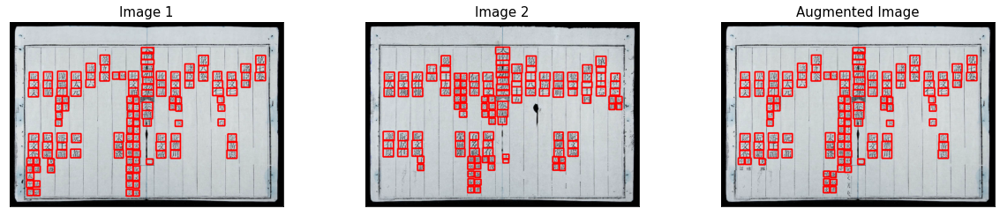

Save images and label of nlvnpf-0137-01-008_nlvnpf-0137-01-017 successfully
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0137-01-024']


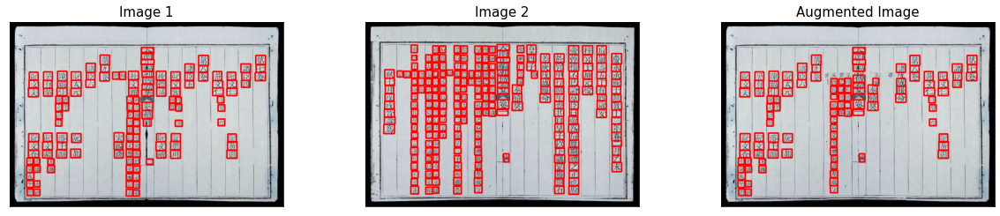

Save images and label of nlvnpf-0137-01-008_nlvnpf-0137-01-033 successfully
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0137-01-040']


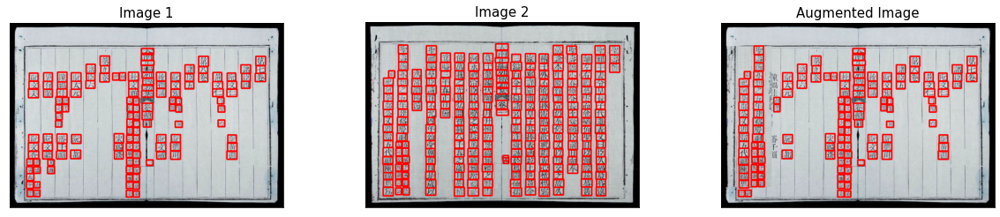

Save images and label of nlvnpf-0137-01-008_nlvnpf-0137-01-043 successfully


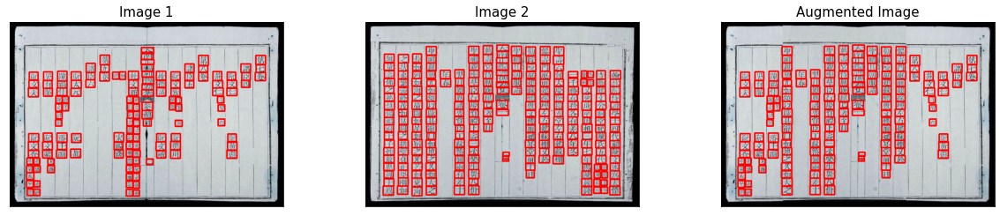

Save images and label of nlvnpf-0137-01-008_nlvnpf-0137-01-044 successfully
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0140-01-015']
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0174-03-002']
Incompatible shape in  ['nlvnpf-0137-01-008', 'nlvnpf-0174-03-012']


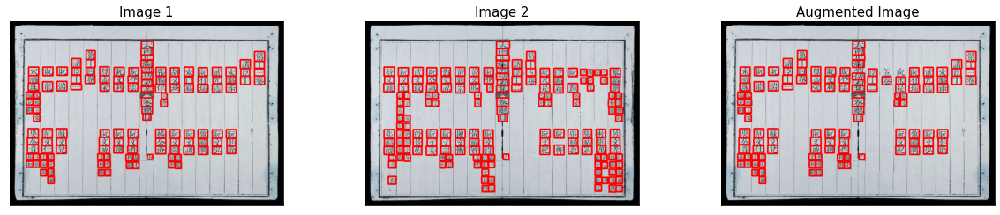

Save images and label of nlvnpf-0137-01-010_nlvnpf-0137-01-011 successfully


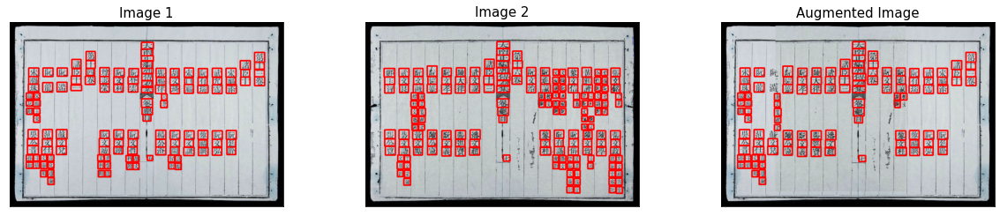

Save images and label of nlvnpf-0137-01-010_nlvnpf-0137-01-012 successfully


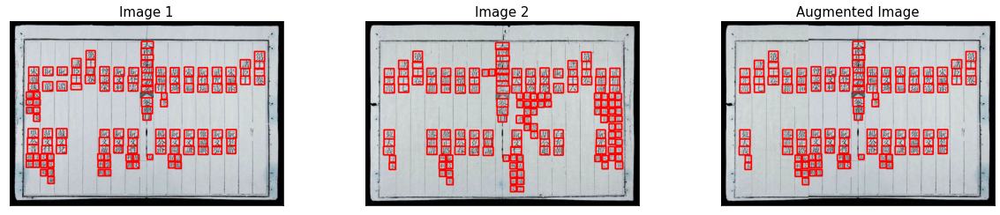

Save images and label of nlvnpf-0137-01-010_nlvnpf-0137-01-014 successfully
Incompatible shape in  ['nlvnpf-0137-01-010', 'nlvnpf-0137-01-015']


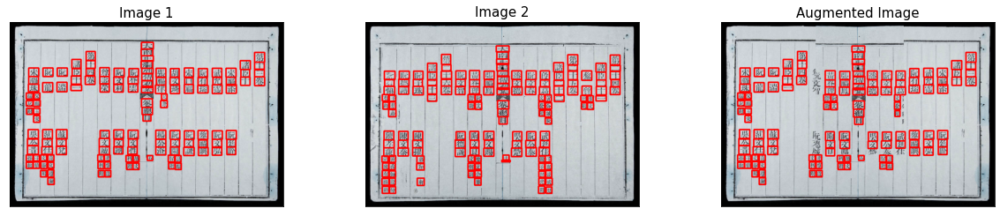

Save images and label of nlvnpf-0137-01-010_nlvnpf-0137-01-016 successfully


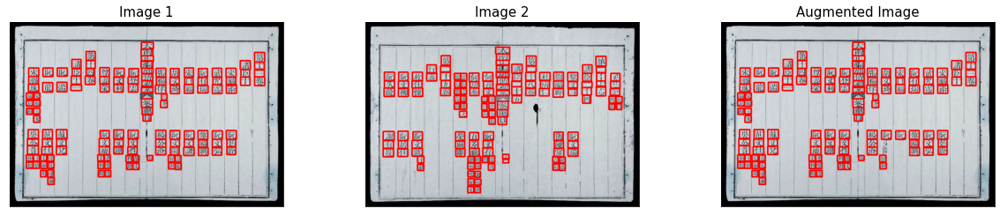

Save images and label of nlvnpf-0137-01-010_nlvnpf-0137-01-017 successfully


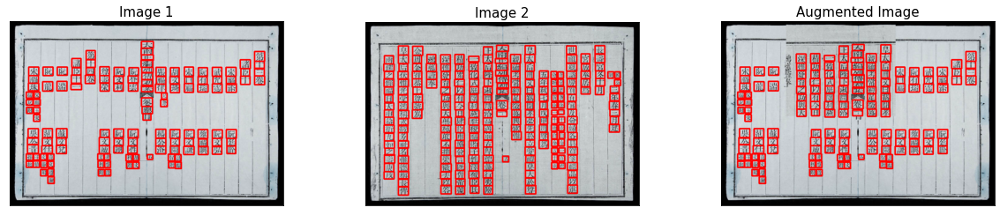

Save images and label of nlvnpf-0137-01-010_nlvnpf-0137-01-024 successfully
Incompatible shape in  ['nlvnpf-0137-01-010', 'nlvnpf-0137-01-033']


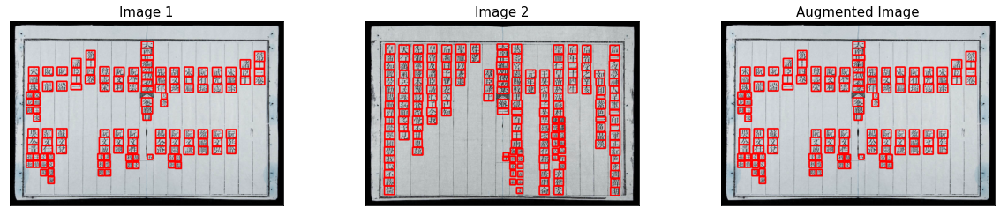

Save images and label of nlvnpf-0137-01-010_nlvnpf-0137-01-040 successfully


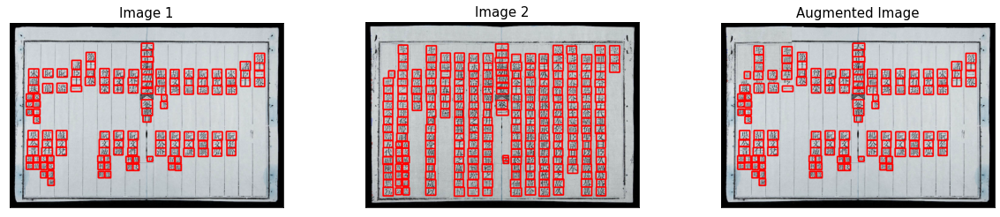

Save images and label of nlvnpf-0137-01-010_nlvnpf-0137-01-043 successfully
Incompatible shape in  ['nlvnpf-0137-01-010', 'nlvnpf-0137-01-044']


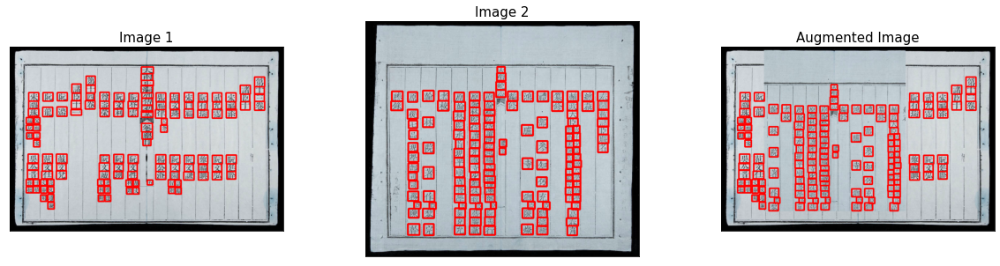

Incompatible shape in  ['nlvnpf-0137-01-010', 'nlvnpf-0140-01-015']
Incompatible shape in  ['nlvnpf-0137-01-010', 'nlvnpf-0174-03-002']
Incompatible shape in  ['nlvnpf-0137-01-010', 'nlvnpf-0174-03-012']
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0137-01-012']


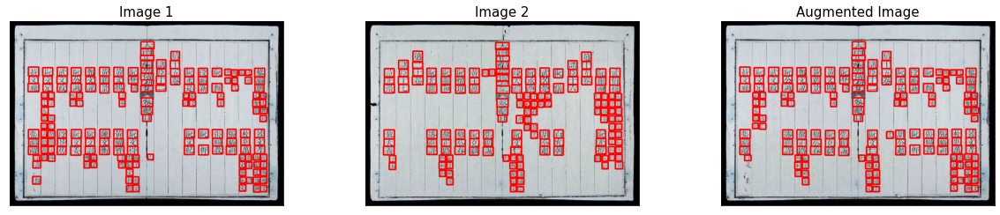

Save images and label of nlvnpf-0137-01-011_nlvnpf-0137-01-014 successfully


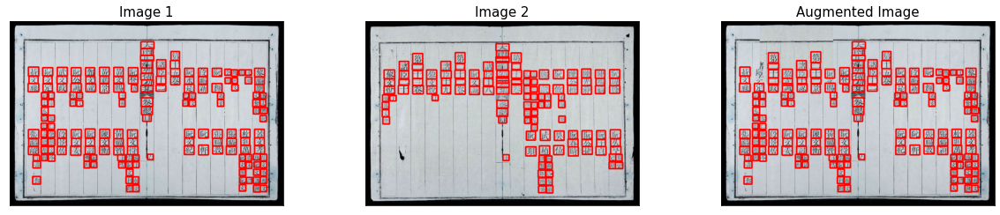

Save images and label of nlvnpf-0137-01-011_nlvnpf-0137-01-015 successfully
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0137-01-016']


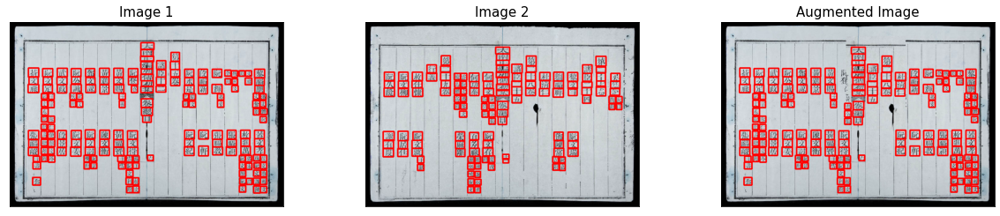

Save images and label of nlvnpf-0137-01-011_nlvnpf-0137-01-017 successfully
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0137-01-024']
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0137-01-033']
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0137-01-040']
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0137-01-043']


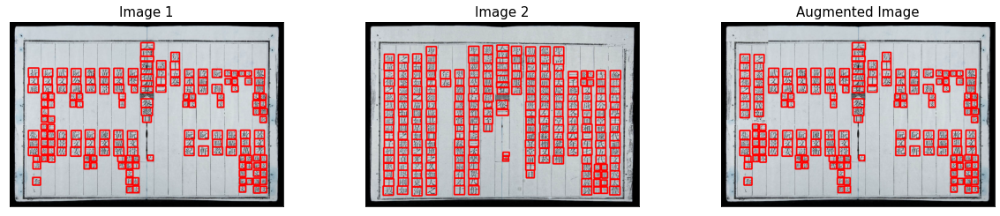

Save images and label of nlvnpf-0137-01-011_nlvnpf-0137-01-044 successfully
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0140-01-015']
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0174-03-002']
Incompatible shape in  ['nlvnpf-0137-01-011', 'nlvnpf-0174-03-012']


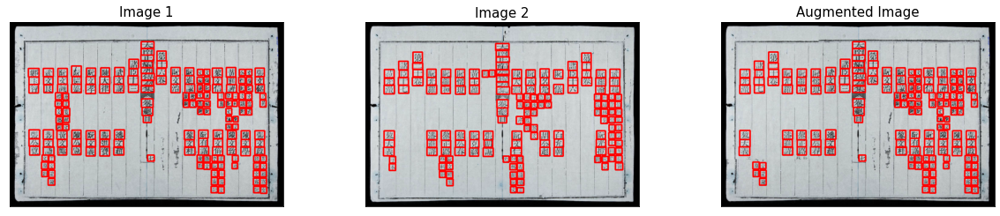

Save images and label of nlvnpf-0137-01-012_nlvnpf-0137-01-014 successfully
Incompatible shape in  ['nlvnpf-0137-01-012', 'nlvnpf-0137-01-015']


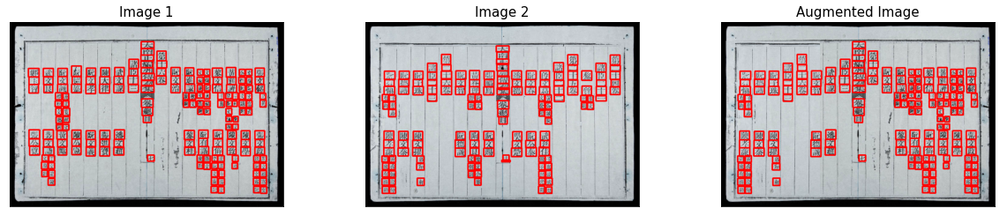

Save images and label of nlvnpf-0137-01-012_nlvnpf-0137-01-016 successfully


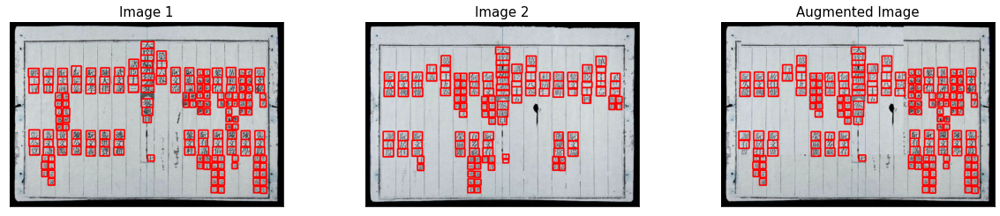

Save images and label of nlvnpf-0137-01-012_nlvnpf-0137-01-017 successfully
Incompatible shape in  ['nlvnpf-0137-01-012', 'nlvnpf-0137-01-024']


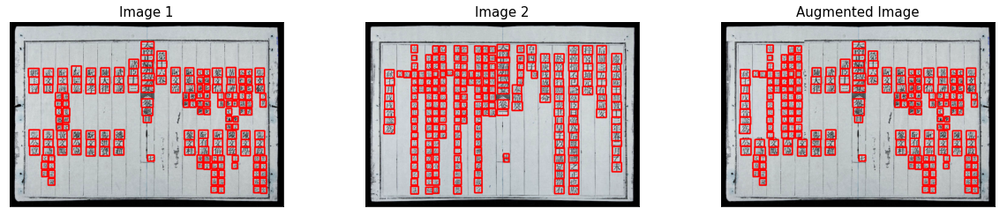

Save images and label of nlvnpf-0137-01-012_nlvnpf-0137-01-033 successfully
Incompatible shape in  ['nlvnpf-0137-01-012', 'nlvnpf-0137-01-040']
Incompatible shape in  ['nlvnpf-0137-01-012', 'nlvnpf-0137-01-043']
Incompatible shape in  ['nlvnpf-0137-01-012', 'nlvnpf-0137-01-044']


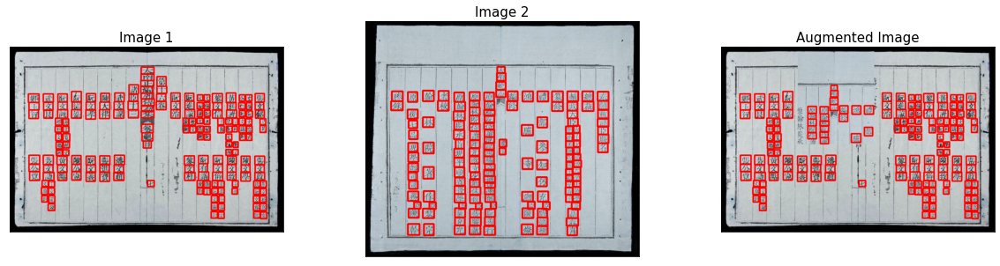

Incompatible shape in  ['nlvnpf-0137-01-012', 'nlvnpf-0140-01-015']


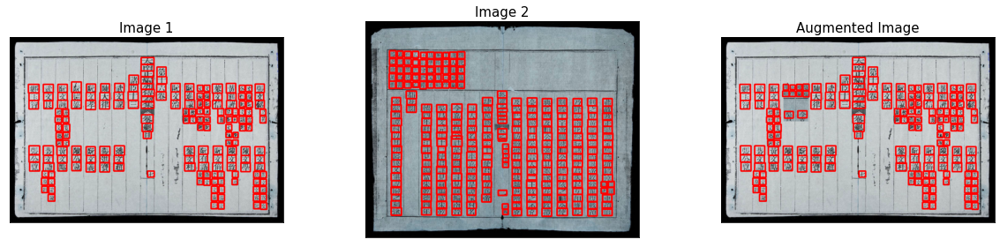

Incompatible shape in  ['nlvnpf-0137-01-012', 'nlvnpf-0174-03-002']
Incompatible shape in  ['nlvnpf-0137-01-012', 'nlvnpf-0174-03-012']
Incompatible shape in  ['nlvnpf-0137-01-014', 'nlvnpf-0137-01-015']


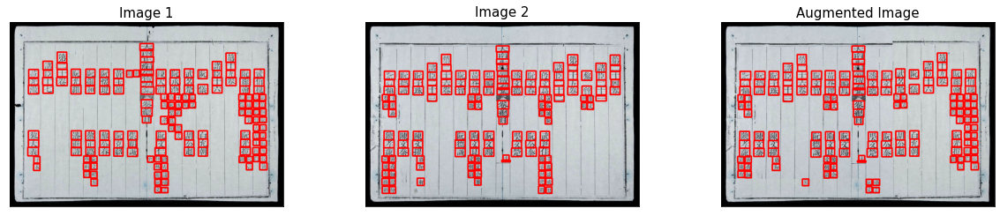

Save images and label of nlvnpf-0137-01-014_nlvnpf-0137-01-016 successfully
Incompatible shape in  ['nlvnpf-0137-01-014', 'nlvnpf-0137-01-017']
Incompatible shape in  ['nlvnpf-0137-01-014', 'nlvnpf-0137-01-024']


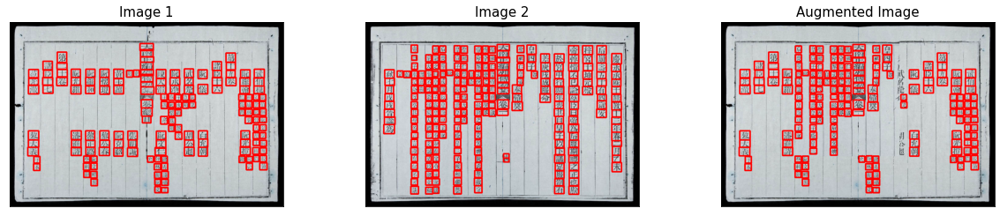

Save images and label of nlvnpf-0137-01-014_nlvnpf-0137-01-033 successfully


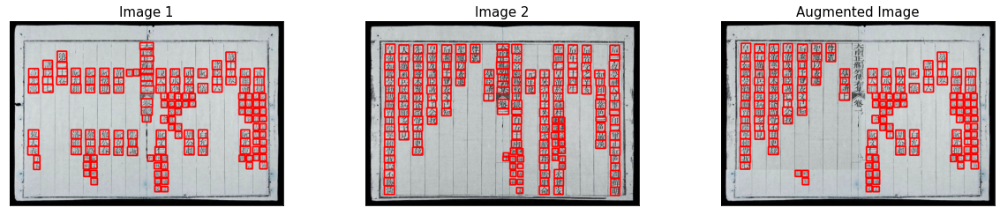

Save images and label of nlvnpf-0137-01-014_nlvnpf-0137-01-040 successfully
Incompatible shape in  ['nlvnpf-0137-01-014', 'nlvnpf-0137-01-043']
Incompatible shape in  ['nlvnpf-0137-01-014', 'nlvnpf-0137-01-044']
Incompatible shape in  ['nlvnpf-0137-01-014', 'nlvnpf-0140-01-015']


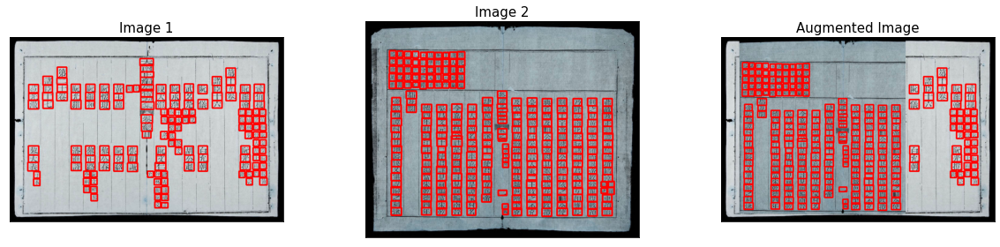

Incompatible shape in  ['nlvnpf-0137-01-014', 'nlvnpf-0174-03-002']


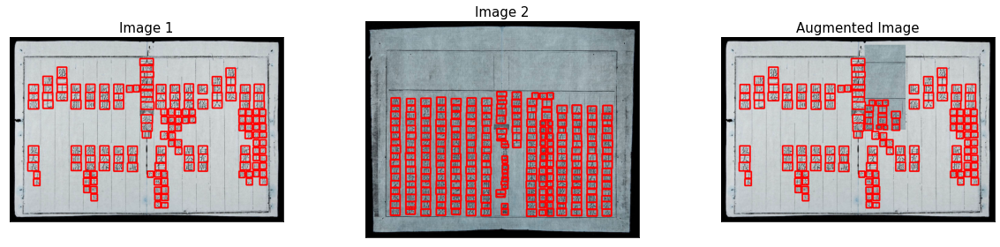

Incompatible shape in  ['nlvnpf-0137-01-014', 'nlvnpf-0174-03-012']
Incompatible shape in  ['nlvnpf-0137-01-015', 'nlvnpf-0137-01-016']
Incompatible shape in  ['nlvnpf-0137-01-015', 'nlvnpf-0137-01-017']
Incompatible shape in  ['nlvnpf-0137-01-015', 'nlvnpf-0137-01-024']


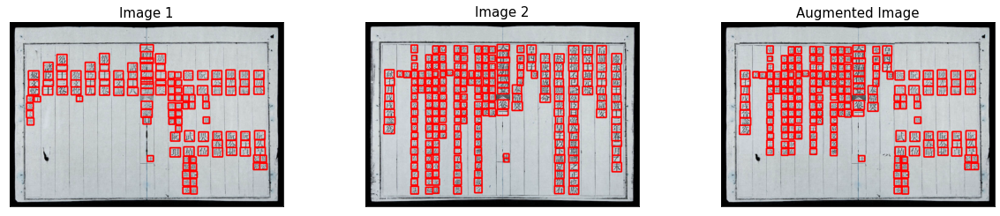

Save images and label of nlvnpf-0137-01-015_nlvnpf-0137-01-033 successfully


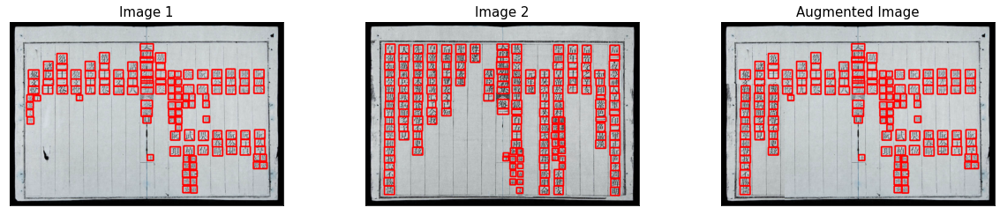

Save images and label of nlvnpf-0137-01-015_nlvnpf-0137-01-040 successfully
Incompatible shape in  ['nlvnpf-0137-01-015', 'nlvnpf-0137-01-043']
Incompatible shape in  ['nlvnpf-0137-01-015', 'nlvnpf-0137-01-044']
Incompatible shape in  ['nlvnpf-0137-01-015', 'nlvnpf-0140-01-015']
Incompatible shape in  ['nlvnpf-0137-01-015', 'nlvnpf-0174-03-002']


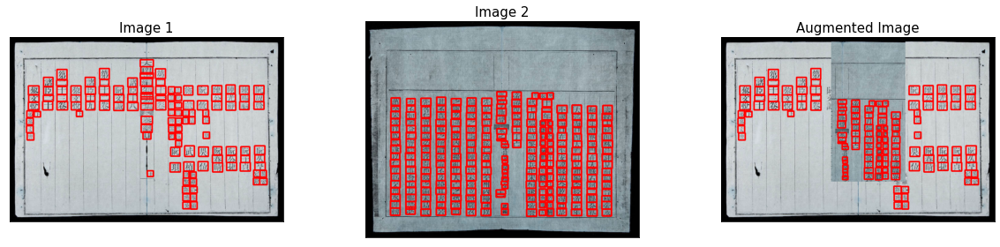

Incompatible shape in  ['nlvnpf-0137-01-015', 'nlvnpf-0174-03-012']


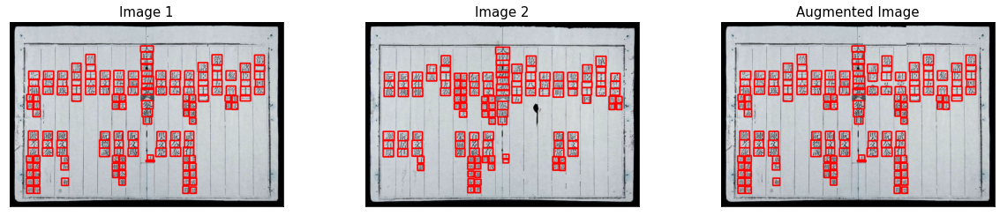

Save images and label of nlvnpf-0137-01-016_nlvnpf-0137-01-017 successfully
Incompatible shape in  ['nlvnpf-0137-01-016', 'nlvnpf-0137-01-024']
Incompatible shape in  ['nlvnpf-0137-01-016', 'nlvnpf-0137-01-033']


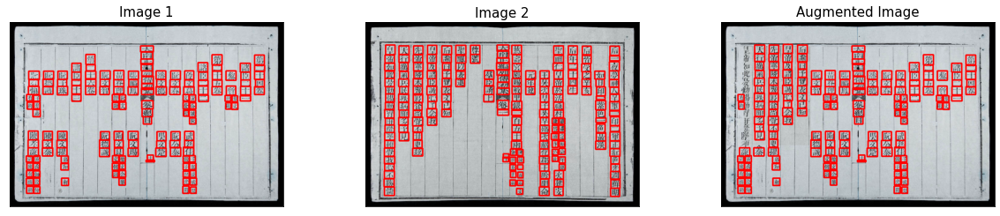

Save images and label of nlvnpf-0137-01-016_nlvnpf-0137-01-040 successfully


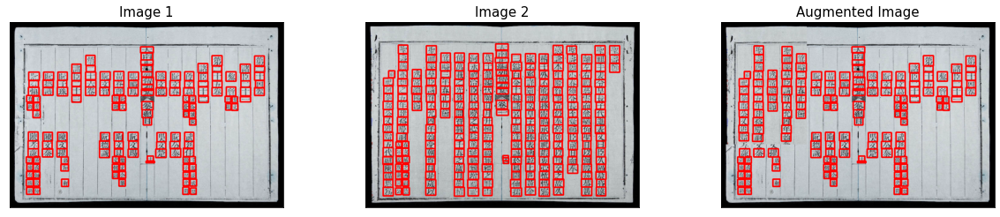

Save images and label of nlvnpf-0137-01-016_nlvnpf-0137-01-043 successfully
Incompatible shape in  ['nlvnpf-0137-01-016', 'nlvnpf-0137-01-044']
Incompatible shape in  ['nlvnpf-0137-01-016', 'nlvnpf-0140-01-015']


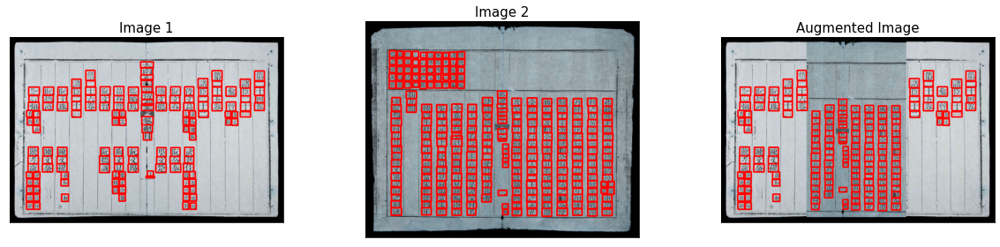

Incompatible shape in  ['nlvnpf-0137-01-016', 'nlvnpf-0174-03-002']
Incompatible shape in  ['nlvnpf-0137-01-016', 'nlvnpf-0174-03-012']


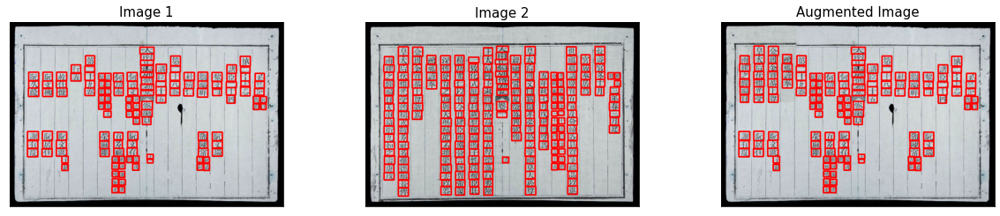

Save images and label of nlvnpf-0137-01-017_nlvnpf-0137-01-024 successfully


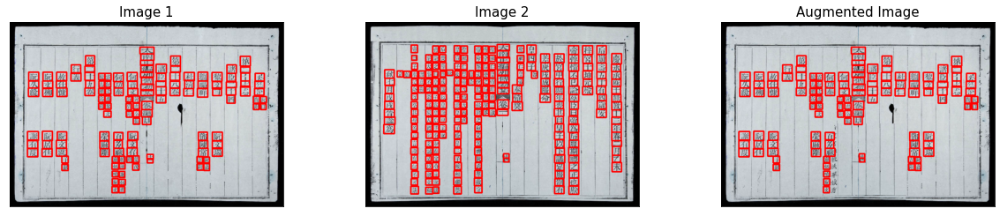

Save images and label of nlvnpf-0137-01-017_nlvnpf-0137-01-033 successfully
Incompatible shape in  ['nlvnpf-0137-01-017', 'nlvnpf-0137-01-040']
Incompatible shape in  ['nlvnpf-0137-01-017', 'nlvnpf-0137-01-043']


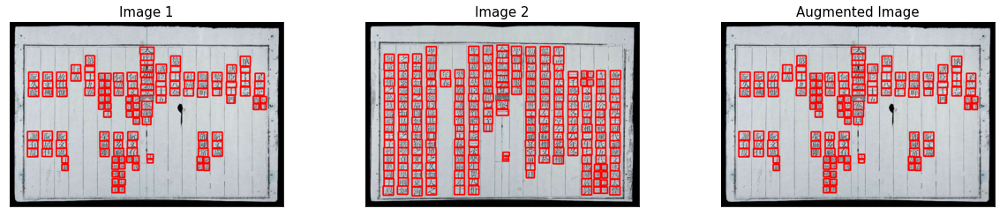

Save images and label of nlvnpf-0137-01-017_nlvnpf-0137-01-044 successfully
Incompatible shape in  ['nlvnpf-0137-01-017', 'nlvnpf-0140-01-015']
Incompatible shape in  ['nlvnpf-0137-01-017', 'nlvnpf-0174-03-002']


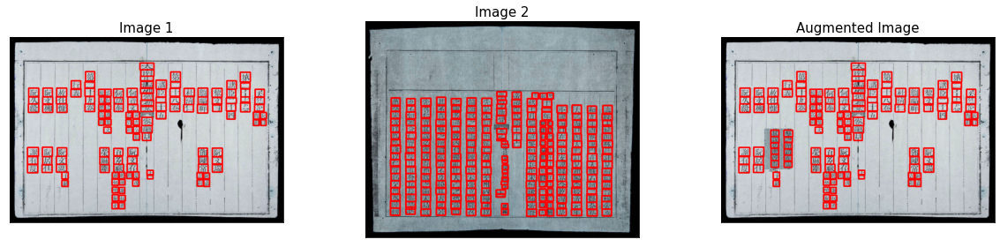

Incompatible shape in  ['nlvnpf-0137-01-017', 'nlvnpf-0174-03-012']
Incompatible shape in  ['nlvnpf-0137-01-024', 'nlvnpf-0137-01-033']
Incompatible shape in  ['nlvnpf-0137-01-024', 'nlvnpf-0137-01-040']
Incompatible shape in  ['nlvnpf-0137-01-024', 'nlvnpf-0137-01-043']


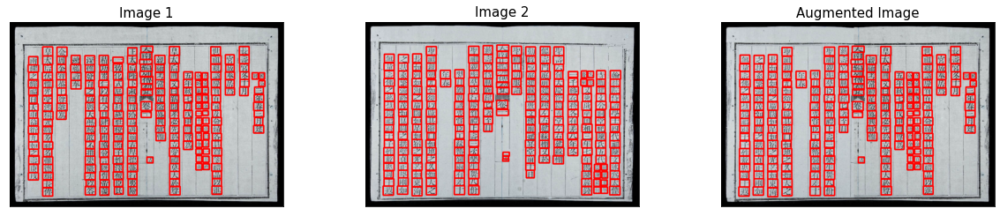

Save images and label of nlvnpf-0137-01-024_nlvnpf-0137-01-044 successfully


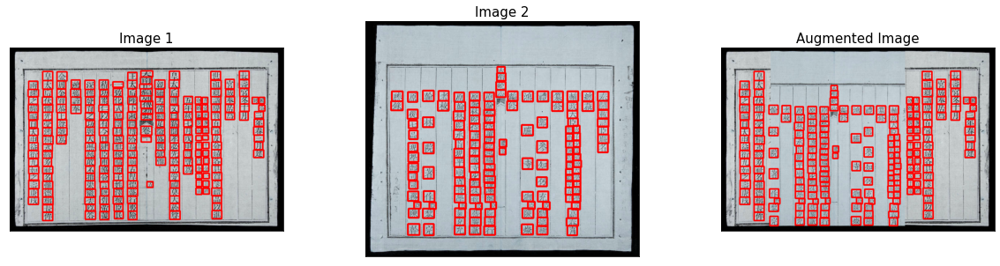

Incompatible shape in  ['nlvnpf-0137-01-024', 'nlvnpf-0140-01-015']


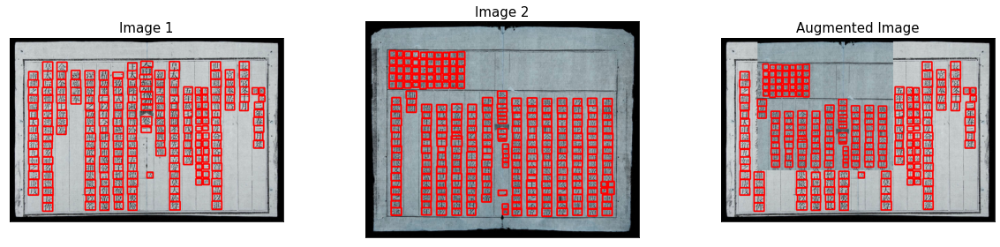

Incompatible shape in  ['nlvnpf-0137-01-024', 'nlvnpf-0174-03-002']


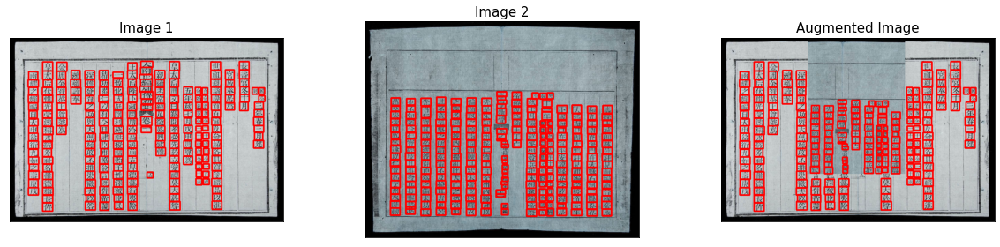

Incompatible shape in  ['nlvnpf-0137-01-024', 'nlvnpf-0174-03-012']


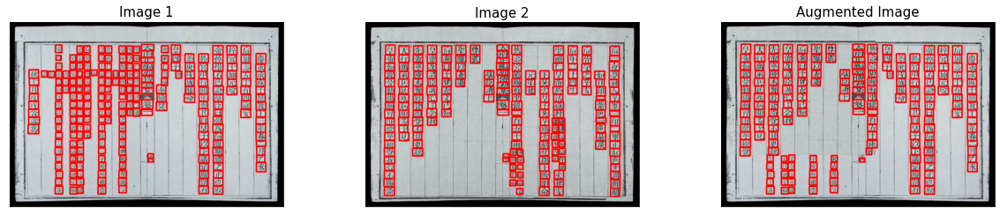

Save images and label of nlvnpf-0137-01-033_nlvnpf-0137-01-040 successfully
Incompatible shape in  ['nlvnpf-0137-01-033', 'nlvnpf-0137-01-043']


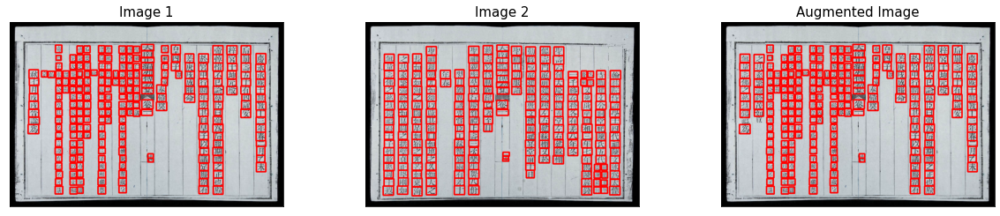

Save images and label of nlvnpf-0137-01-033_nlvnpf-0137-01-044 successfully
Incompatible shape in  ['nlvnpf-0137-01-033', 'nlvnpf-0140-01-015']
Incompatible shape in  ['nlvnpf-0137-01-033', 'nlvnpf-0174-03-002']


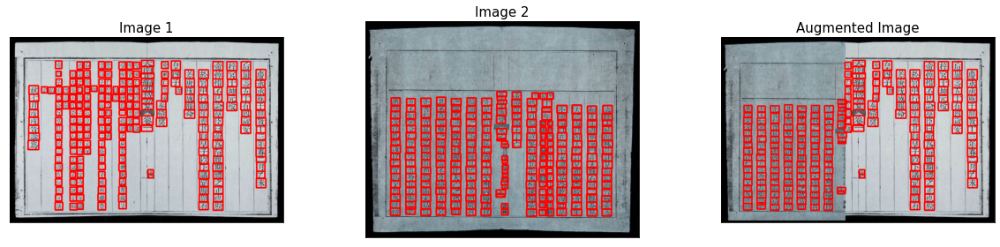

Incompatible shape in  ['nlvnpf-0137-01-033', 'nlvnpf-0174-03-012']
Incompatible shape in  ['nlvnpf-0137-01-040', 'nlvnpf-0137-01-043']
Incompatible shape in  ['nlvnpf-0137-01-040', 'nlvnpf-0137-01-044']
Incompatible shape in  ['nlvnpf-0137-01-040', 'nlvnpf-0140-01-015']


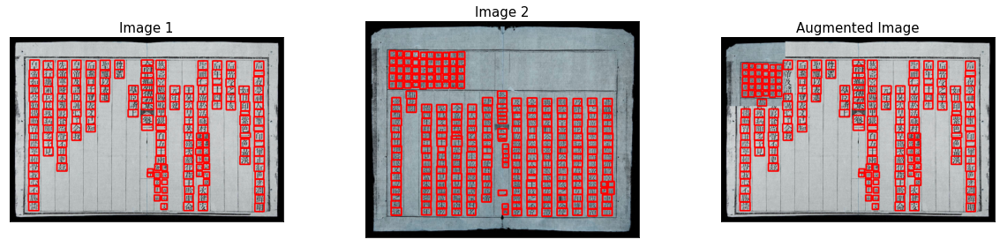

Incompatible shape in  ['nlvnpf-0137-01-040', 'nlvnpf-0174-03-002']


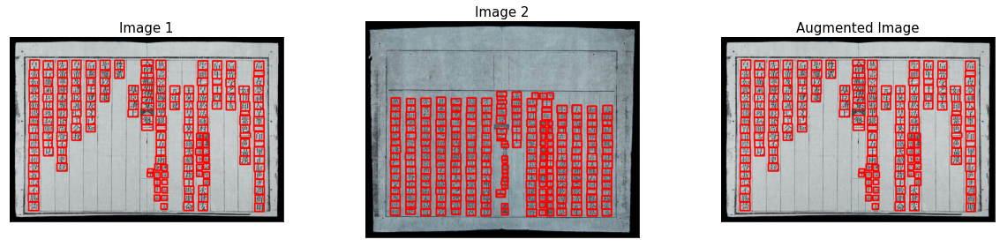

Incompatible shape in  ['nlvnpf-0137-01-040', 'nlvnpf-0174-03-012']
Incompatible shape in  ['nlvnpf-0137-01-043', 'nlvnpf-0137-01-044']
Incompatible shape in  ['nlvnpf-0137-01-043', 'nlvnpf-0140-01-015']


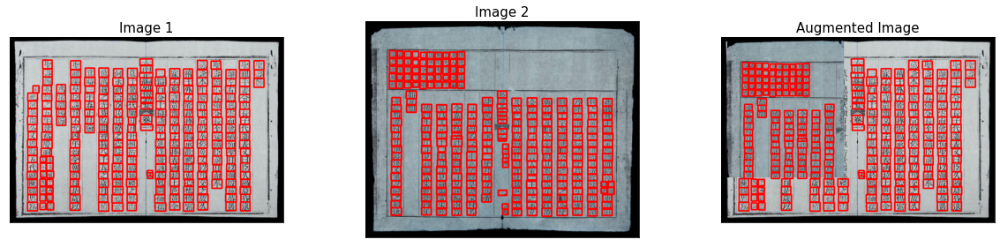

Incompatible shape in  ['nlvnpf-0137-01-043', 'nlvnpf-0174-03-002']
Incompatible shape in  ['nlvnpf-0137-01-043', 'nlvnpf-0174-03-012']
Incompatible shape in  ['nlvnpf-0137-01-044', 'nlvnpf-0140-01-015']
Incompatible shape in  ['nlvnpf-0137-01-044', 'nlvnpf-0174-03-002']


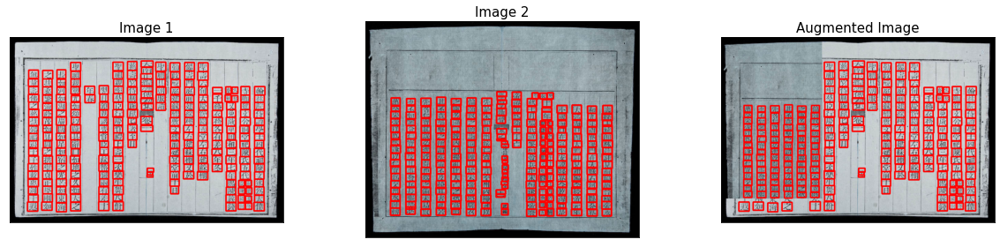

Incompatible shape in  ['nlvnpf-0137-01-044', 'nlvnpf-0174-03-012']


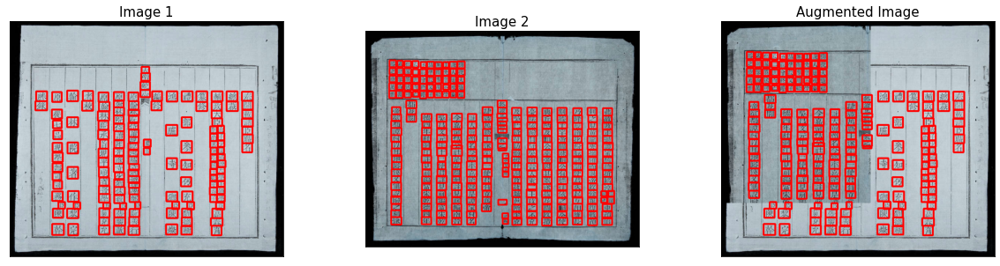

Incompatible shape in  ['nlvnpf-0140-01-015', 'nlvnpf-0174-03-002']
Incompatible shape in  ['nlvnpf-0140-01-015', 'nlvnpf-0174-03-012']


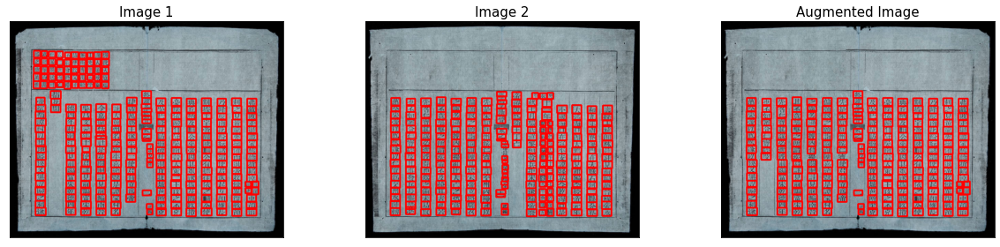

Save images and label of nlvnpf-0174-03-002_nlvnpf-0174-03-012 successfully


In [23]:
for image_ids in image_ids_list:
    try:
        images = [read_img(img_id)    for img_id in image_ids]
        bboxes = [read_bboxes(img_id) for img_id in image_ids]

        aug_image, aug_bbox = generate_cutmix_image(images, bboxes)

        images += [aug_image]
        bboxes += [aug_bbox]

        img_matrix_list = []
        for img, bbox in zip(images, bboxes): 
            img_matrix_list.append(draw_rect(img, bbox))

        titles_list     = ['Image 1', 'Image 2', 'Augmented Image']
        plot_multiple_img(img_matrix_list, titles_list, ncols = 3, nrows= 1, main_title="")

        # SAVE AUGMENTED IMAGE AND LABEL 
        img_id = '_'.join(image_ids)
        combined_img = np.vstack(img_matrix_list)  # img_matrix_list là list của các ma trận ảnh
        cv2.imwrite(os.path.join(output_dir_cutmix_images, f'{img_id}_cutmix.jpg'), aug_image)
        cv2.imwrite(os.path.join(output_dir_cutmix_double_check, f'{img_id}_cutmix_1_2_aug.jpg'), combined_img)

        # convert Pascal VOC to YOLO format and save output
        with open(os.path.join(output_dir_cutmix_label, f'{img_id}_cutmix.txt'), 'w') as label_file:
            img_height, img_width, _ = img.shape
            for bbox in aug_bbox:

                # convert Pascal VOC to YOLO format
                x_min, y_min, x_max, y_max = bbox
                x_center = (x_min + x_max) / 2 / img_width
                y_center = (y_min + y_max) / 2 / img_height
                width = (x_max - x_min) / img_width
                height = (y_max - y_min) / img_height

                # save output
                label_file.write(f'0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n')
        print("Save images and label of", img_id, "successfully")
    except:
        print("Incompatible shape in ", image_ids)